# **EE610 ASSIGNMENT 3**

By
 Neeraj Nixon(20D070056)

In [250]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [251]:
import numpy as np
from scipy import signal
import cv2
from google.colab.patches import cv2_imshow
import pywt
import matplotlib.pyplot as plt

## **Ques 1(a) - AWGN**

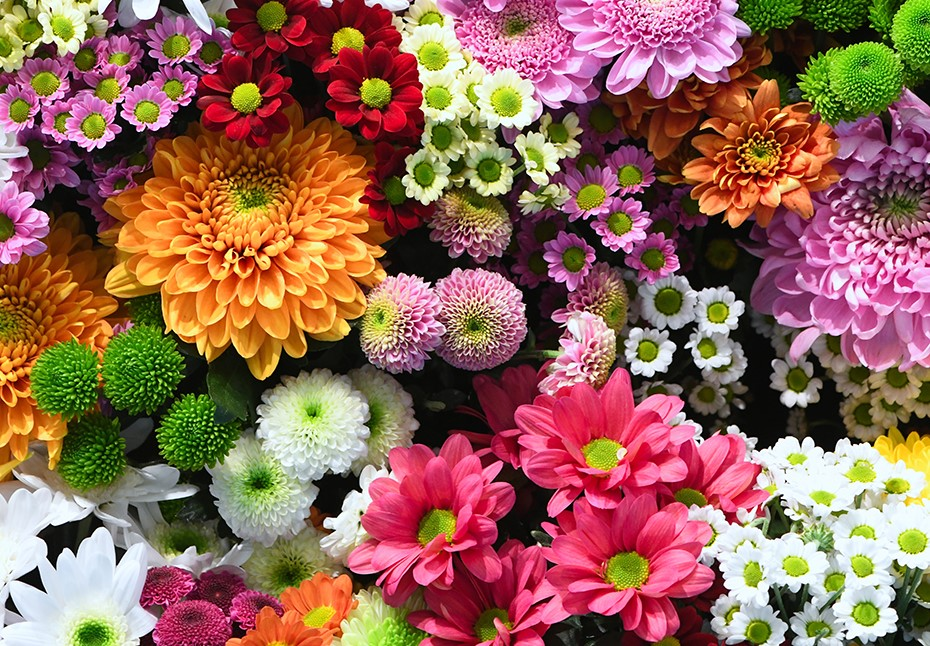

In [256]:
#reading the test image
img=cv2.imread('/content/ip3.jpg')
#showing image
cv2_imshow(img)

### Function to add Additive White Gaussian Noise to an input image

In [308]:
def AWGN(img,var):
  shape=img.shape # getting shape of image
  #Checking if image is color or grayscale and adding AGWN 
  n=np.random.normal(0,np.sqrt(var),size=shape)# Creating numpy array containing noise
  imgn=img+n # Adding noise to input image   
  return imgn

### Sample output

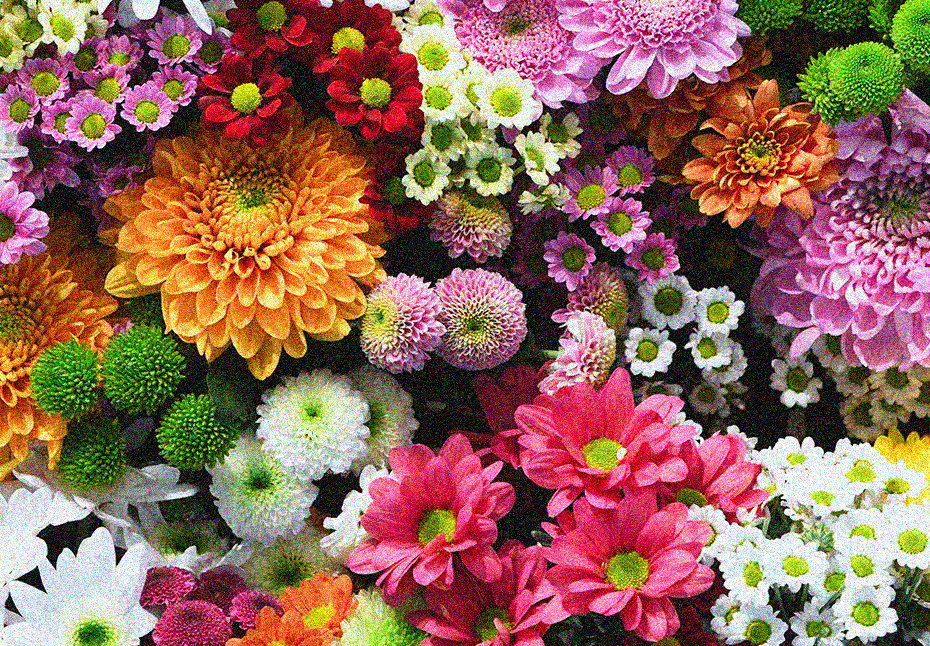

In [309]:
# Test output
cv2_imshow(AWGN(img,1000))

## **Ques 1(b) - PSNR**

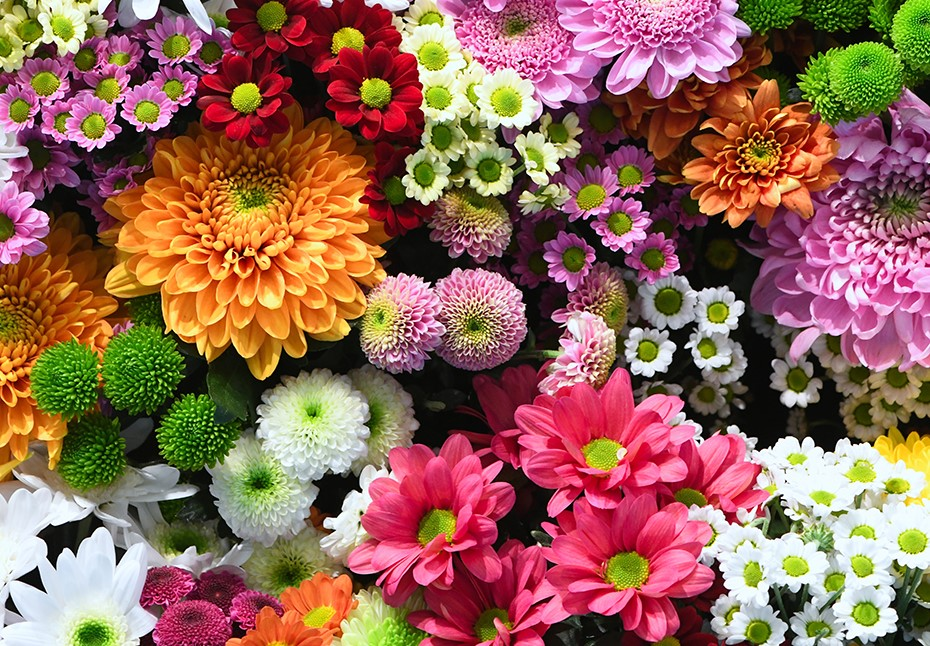

In [310]:
#reading the test image
img=cv2.imread('/content/ip3.jpg')
#showing image
cv2_imshow(img)

### Function to calculate Peak Signal to Noise Ratio when image and its noisy version are inputed

In [311]:
def PSNR(img2,img1,max=255):
  error=np.sqrt(np.mean((img2-img1)**2)) # Calculating  RMSE of both images
  psnr=20*np.log10(max/error) # Calculating PSNR
  return psnr

### Sample output

In [312]:
# Getting sample output
PSNR(img,AWGN(img,1000))

18.132402366253437

## **Ques 1(c) - SSIM**

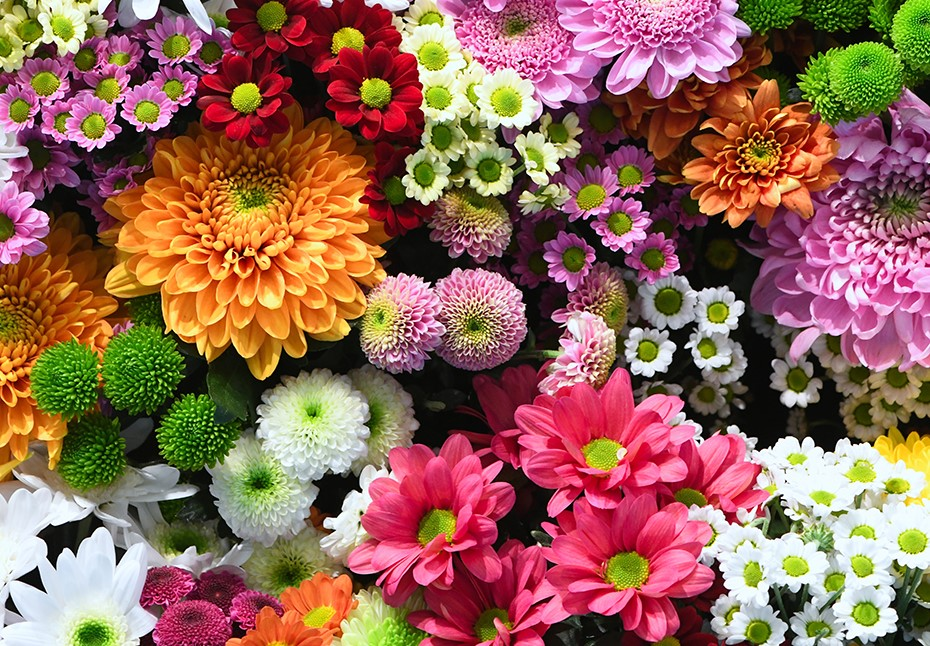

In [313]:
#reading the test image
img=cv2.imread('/content/ip3.jpg')
#showing image
cv2_imshow(img)

### Function to calculate SSIM of 2 images

#### Function to calculate SSIM of gray image

In [314]:
def gray_ssim(img1,img2,a,b,c):
    m1=np.mean(img1)
    m2=np.mean(img2)
    v1=np.std(img1)
    v2=np.std(img2)
    img1=np.reshape(img1,(1,img1.size))
    img2=np.reshape(img2,(1,img2.size))
    coxy=np.cov(img1,img2)[1][0]
    c1=(0.01*255)**2
    c2=(0.03*255)**2
    c3=c2/2
    lxy=(2*m1*m2+c1)/(m1**2+m2**2+c1)
    cxy=(2*v1*v2+c2)/(v1**2+v2**2+c2)
    sxy=(coxy+c3)/(v1*v2+c3)
    ssim=(lxy**a)*(cxy*b)*(sxy*c)
    return ssim

#### Function to calculate SSIM of color images

In [315]:
def color_ssim(img1,img2,a,b,c,red,green):
  import cv2
  blue=1-red-green
  Bx,Gx,Rx=cv2.split(img1)
  By,Gy,Ry=cv2.split(img2)
  sb=gray_ssim(Bx,By,a,b,c)
  sg=gray_ssim(Gx,Gy,a,b,c)
  sr=gray_ssim(Rx,Ry,a,b,c)
  ssim=sb*blue+sg*green+sr*red
  return ssim

#### Combining the above 2 functions to create 1 common SSIM function

In [316]:
def SSIM(img1,img2,a=1,b=1,c=1,r=1/3,g=1/3):
  if img1.ndim==2:
    return gray_ssim(img1,img2,a,b,c)
  if img1.ndim==3:
    return color_ssim(img1,img2,a,b,c,r,g)

### Sampe output

In [317]:
# Getting sample output
SSIM(img,AWGN(img,1000))

0.92680381252743

## **Ques 1(d) - Isotropic Gaussian Blurring**

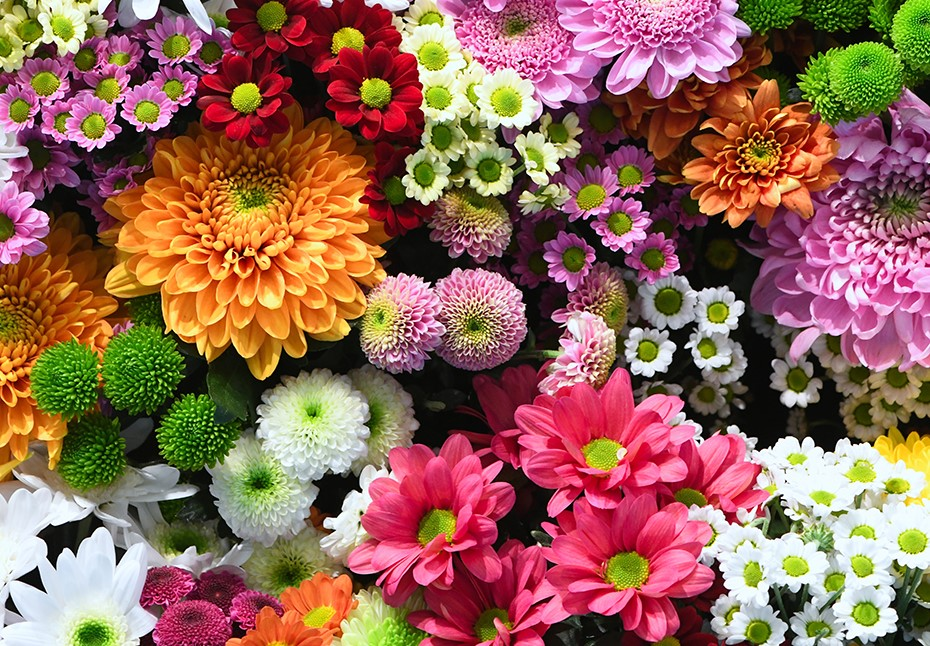

In [318]:
#reading the test image
img=cv2.imread('/content/ip3.jpg')
#showing image
cv2_imshow(img)

### Function to generate Isotropic Gaussian Blurred image

In [319]:
def IGB(img,var):
  igb=cv2.GaussianBlur(img,(5,5),var)
  return igb

### Sample output

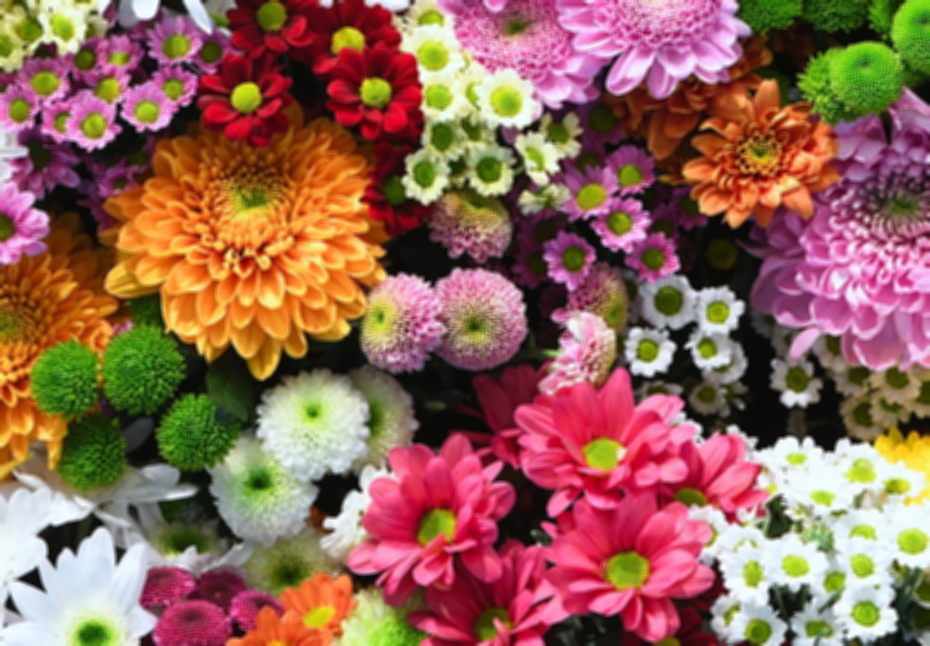

In [320]:
# Test output
cv2_imshow(IGB(img,10))

## **Ques 2(a) - Hard Thresholding**

Reference for 2D Forward and Inverse Discrete Wavelet Transform:https://pywavelets.readthedocs.io/en/latest/ref/2d-dwt-and-idwt.html

Reference for Thresholding: https://pywavelets.readthedocs.io/en/latest/ref/thresholding-functions.html



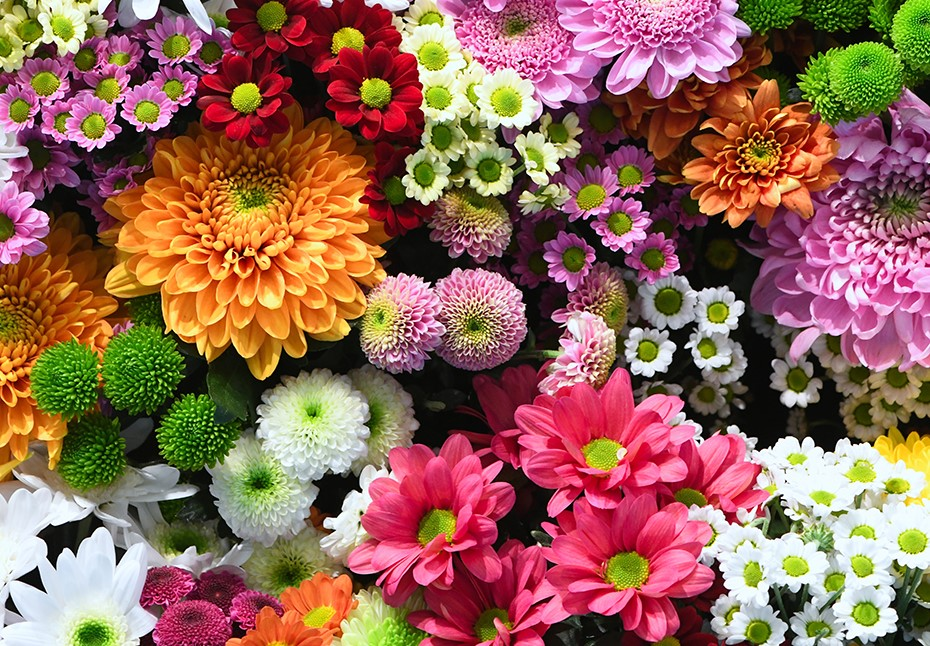

In [321]:
#reading the test image
img=cv2.imread('/content/ip3.jpg')
#showing image
cv2_imshow(img)

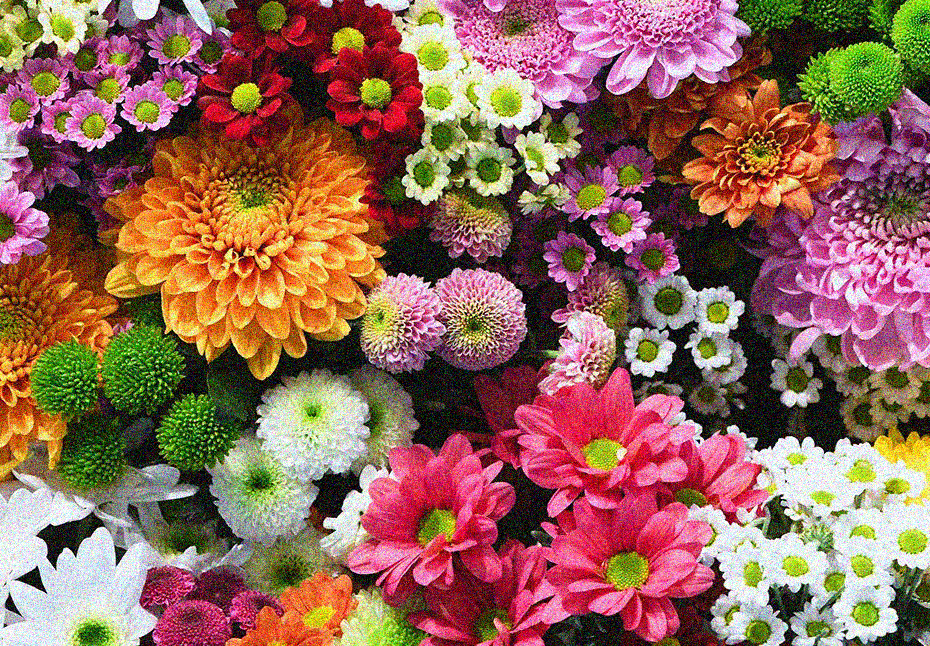

In [324]:
# Test input for Hard thresholding after adding AWGN
cv2_imshow(AWGN(img,1000))

### Function for Hard Thresholding

#### Function for Hard thresholding gray scale



In [325]:
def gray_hard(img,t):
  coeffs = pywt.dwt2(img, 'haar')
  cA, (cH, cV, cD) = coeffs
  cH=pywt.threshold(cH, t, 'hard')
  cV=pywt.threshold(cV, t, 'hard')
  cD=pywt.threshold(cD, t, 'hard')
  coeffs=cA, (cH, cV, cD)
  hard=pywt.idwt2(coeffs, 'haar')
  return hard

#### Function for Hard thresholding color image

In [326]:
def color_hard(img,t):
  B,G,R=cv2.split(img)
  Bn=gray_hard(B,t)
  Gn=gray_hard(G,t)
  Rn=gray_hard(R,t)
  hard=cv2.merge((Bn,Gn,Rn))
  return hard

#### Combining the above two functions to form a general Hard Threshold function

In [327]:
def HARDTHRESHOLD(img,t):
  if img.ndim==2:
    return gray_hard(img,t)
  if img.ndim==3:
    return color_hard(img,t)

### Sample output

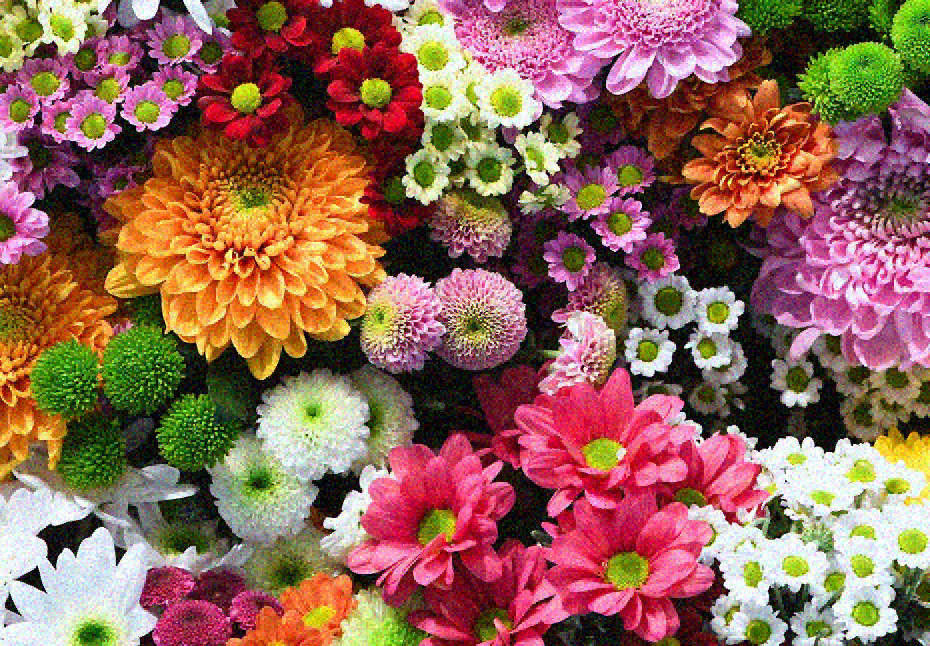

In [329]:
# Test output
cv2_imshow(HARDTHRESHOLD(AWGN(img,1000),100))

## **Ques 2(b) - Soft Thresholding**

Reference for 2D Forward and Inverse Discrete Wavelet Transform:https://pywavelets.readthedocs.io/en/latest/ref/2d-dwt-and-idwt.html

Reference for Thresholding: https://pywavelets.readthedocs.io/en/latest/ref/thresholding-functions.html

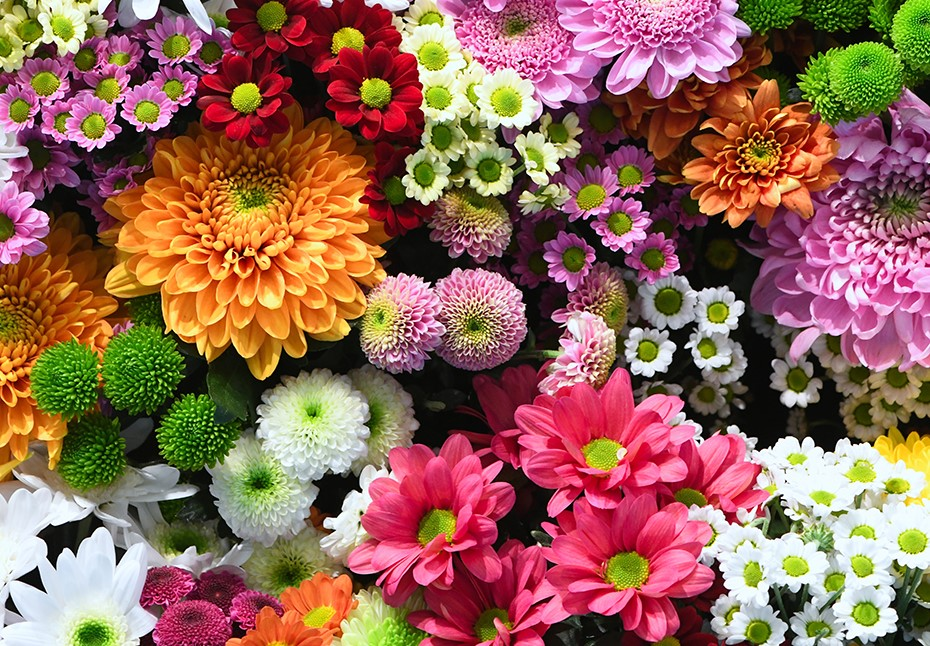

In [330]:
#reading the test image
img=cv2.imread('/content/ip3.jpg')
#showing image
cv2_imshow(img)

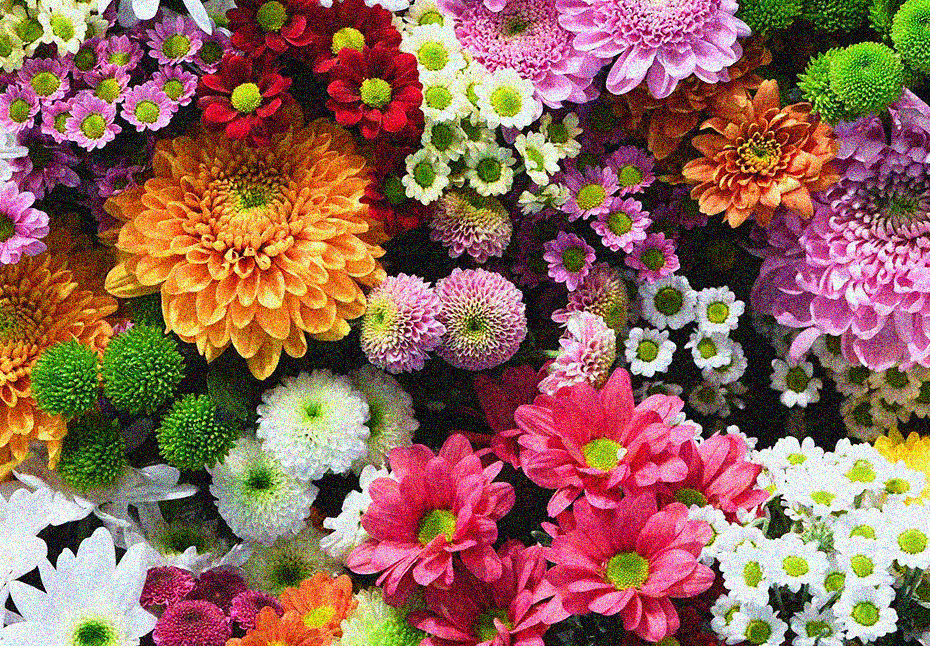

In [331]:
# Test input for Hard thresholding after adding AWGN
cv2_imshow(AWGN(img,1000))

### Function for Soft Thresholding

#### Function for Soft thresholding gray scale

In [332]:
def gray_soft(img,t):
  coeffs = pywt.dwt2(img, 'haar')
  cA, (cH, cV, cD) = coeffs
  cH=pywt.threshold(cH, t,)
  cV=pywt.threshold(cV, t,)
  cD=pywt.threshold(cD, t,)
  coeffs=cA, (cH, cV, cD)
  soft=pywt.idwt2(coeffs, 'haar')
  return soft

#### Function for Soft thresholding color image

In [333]:
def color_soft(img,t):
  B,G,R=cv2.split(img)
  Bn=gray_hard(B,t)
  Gn=gray_hard(G,t)
  Rn=gray_hard(R,t)
  soft=cv2.merge((Bn,Gn,Rn))
  return soft

#### Combining the above two functions to form a general Soft Threshold function

In [334]:
def SOFTTHRESHOLD(img,t):
  if img.ndim==2:
    return gray_soft(img,t)
  if img.ndim==3:
    return color_soft(img,t)

### Sample output

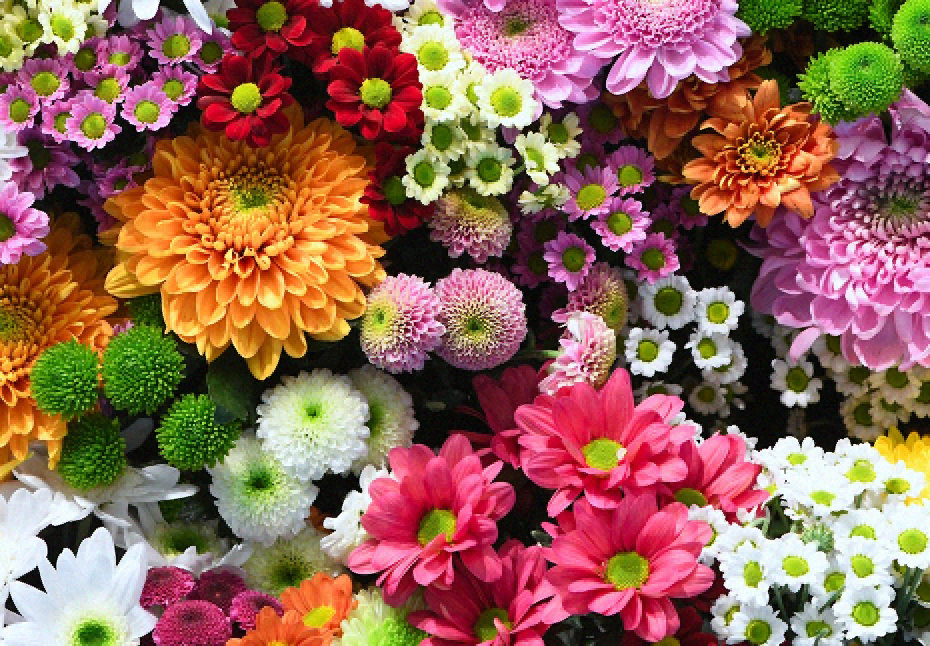

In [335]:
# Test output
cv2_imshow(SOFTTHRESHOLD(AWGN(img,50),100))

## **Ques 3(a) - Noise Variance**

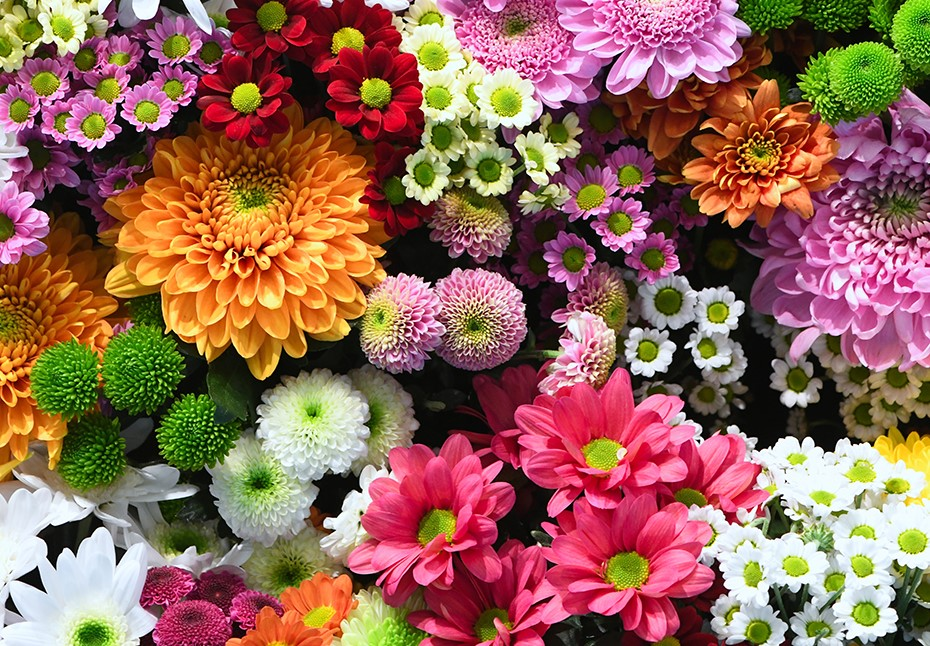

In [336]:
#reading the test image
img=cv2.imread('/content/ip3.jpg')
#showing image
cv2_imshow(img)

### PSNR v/s Noise Variance

<function matplotlib.pyplot.show(*args, **kw)>

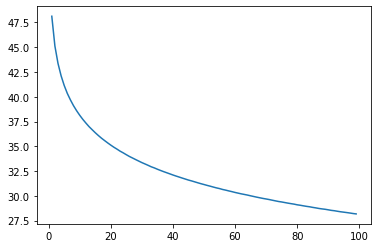

In [337]:
ps=[]
for var in range(1,100):
  imgn=AWGN(img,var) #Adding AWGN to the image with variance ranging from 1 to 1000 
  psnr=PSNR(img,imgn)# Calculating PSNR of original image and the noisy one for all values of variances
  ps.append(psnr)
var=np.arange(1,100)
plt.plot(var,ps)# plotting PSNR vs Variance graph
plt.show

### SSIM v/s Noise Variance

<function matplotlib.pyplot.show(*args, **kw)>

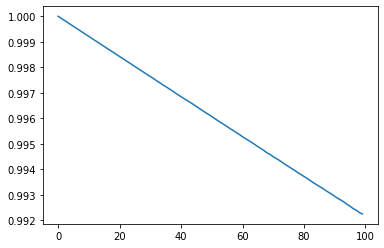

In [338]:
ps=[]
for var in range(100):
  imgn=AWGN(img,var)#Adding AWGN to the image with variance ranging from 1 to 1000 
  ssim=SSIM(img,imgn)# Calculating SSIM of original image and the noisy one for all values of variances
  ps.append(ssim)
var=np.arange(100)
plt.plot(var,ps)# plotting SSIM vs Variance graph
plt.show

## **Ques 3(b) - Gaussian Filtering Variance**

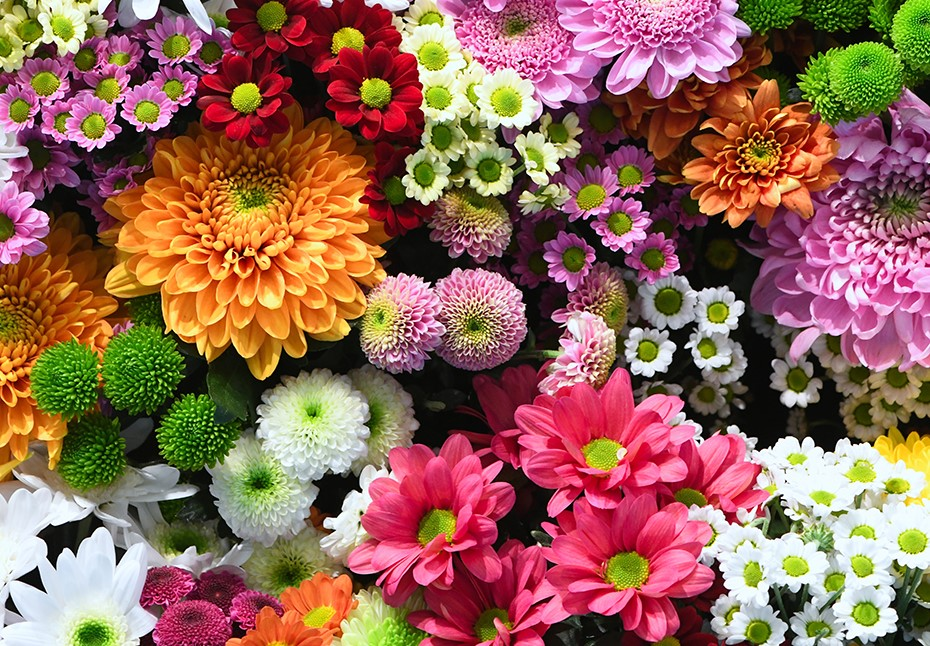

In [339]:
#reading the test image
img=cv2.imread('/content/ip3.jpg')
#showing image
cv2_imshow(img)

### PSNR v/s Gaussian Filter Variance

<function matplotlib.pyplot.show(*args, **kw)>

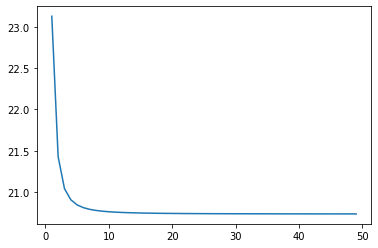

In [340]:
ps=[]
imgn=AWGN(img,1000) # Adding AWGN of variance 1000 to the image
for var in range(1,50):
  imgg=IGB(imgn,var) # Applying Gaussian Filter of different variance ranging from 1 to 50
  psnr=PSNR(img,imgg)# Calculating PSNR of Blurred image and original image for all variances
  ps.append(psnr)
var=np.arange(1,50)
plt.plot(var,ps)# Plotting PSNR vs Variance graph
plt.show

### SSIM v/s Gaussian Filter Variance

<function matplotlib.pyplot.show(*args, **kw)>

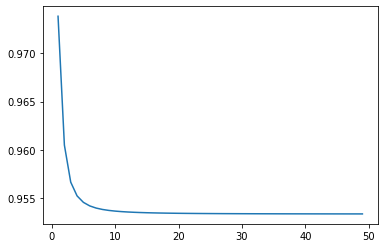

In [341]:
ps=[]
imgn=AWGN(img,1000)# Adding AWGN of variance 1000 to the image
for var in range(1,50):
  imgg=IGB(imgn,var)# Applying Gaussian Filter of different variance ranging from 1 to 50
  ssim=SSIM(img,imgg)# Calculating SSIM of Blurred image and original image for all variances
  ps.append(ssim)
var=np.arange(1,50)
plt.plot(var,ps)# Plotting SSIM vs Variance graph
plt.show

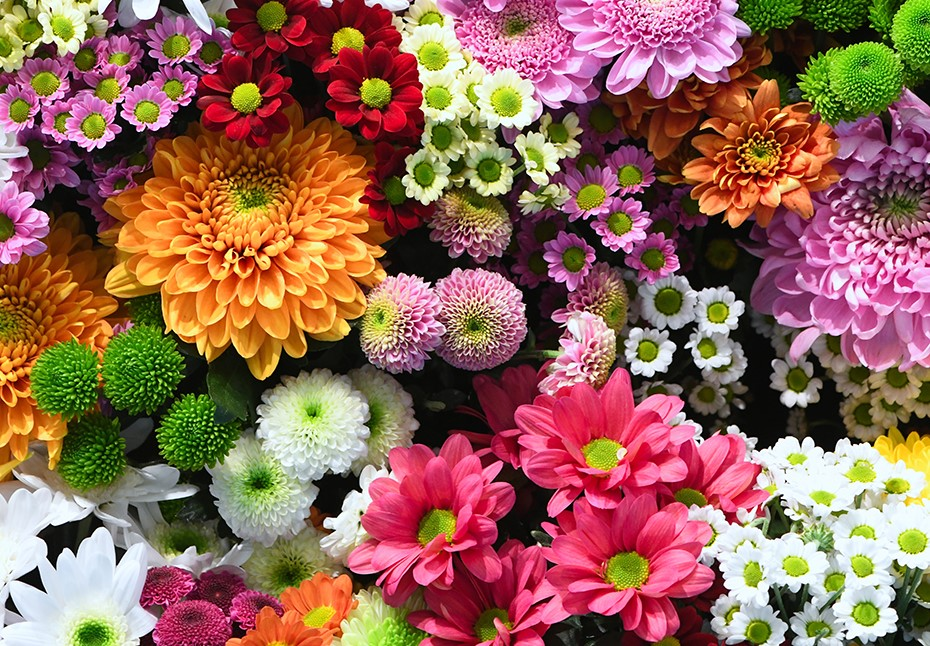

In [342]:
#reading the test image
img=cv2.imread('/content/ip3.jpg')
#showing image
cv2_imshow(img)

## **Ques 3(c) - Thresholding**

###Soft Thresholding

#### PSNR vs Noise Variance

<function matplotlib.pyplot.show(*args, **kw)>

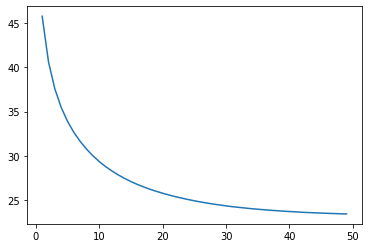

In [343]:
ps=[]
shape=img.shape
for var in range(1,50):
  l=var*np.sqrt(2*np.log10(shape[0]*shape[1]))# Calculating the value of threshold lambda
  imgn=AWGN(img,var)#Adding AWGN of varying Variance
  imgs=SOFTTHRESHOLD(imgn,l)#Soft thresholding
  psnr=PSNR(img,imgs)#calculating PSNR
  ps.append(psnr)
var=np.arange(1,50)
plt.plot(var,ps)#Plotting PSNR vs Variance
plt.show

#### SSIM vs Noise Variance

<function matplotlib.pyplot.show(*args, **kw)>

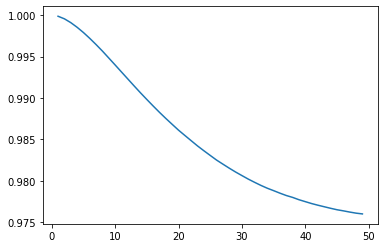

In [344]:
ps=[]
shape=img.shape
for var in range(1,50):
  l=var*np.sqrt(2*np.log10(shape[0]*shape[1]))# Calculating the value of threshold lambda
  imgn=AWGN(img,var)#Adding AWGN of varying Variance
  imgs=SOFTTHRESHOLD(imgn,l)#Soft thresholding
  ssim=SSIM(img,imgs)#calculating SSIM
  ps.append(ssim)
var=np.arange(1,50)
plt.plot(var,ps)#Plotting SSIM vs Variance
plt.show

###Hard Thresholding

####PSNR vs Noise Variance

<function matplotlib.pyplot.show(*args, **kw)>

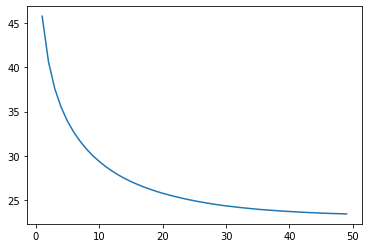

In [345]:
ps=[]
shape=img.shape
for var in range(1,50):
  l=var*np.sqrt(2*np.log10(shape[0]*shape[1]))# Calculating the value of threshold lambda
  imgn=AWGN(img,var)#Adding AWGN of varying Variance
  imgs=HARDTHRESHOLD(imgn,l)#Hard thresholding
  psnr=PSNR(img,imgs)#calculating PSNR
  ps.append(psnr)
var=np.arange(1,50)
plt.plot(var,ps)#Plotting PSNR vs Variance
plt.show

####SSIM vs Noise Variance

<function matplotlib.pyplot.show(*args, **kw)>

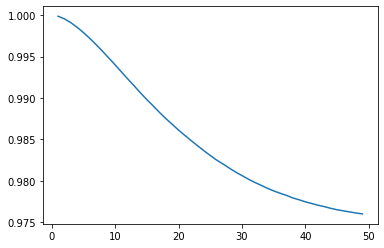

In [346]:
ps=[]
shape=img.shape
for var in range(1,50):
  l=var*np.sqrt(2*np.log10(shape[0]*shape[1]))# Calculating the value of threshold lambda
  imgn=AWGN(img,var)#Adding AWGN of varying Variance
  imgs=HARDTHRESHOLD(imgn,l)#Hard thresholding
  ssim=SSIM(img,imgs)
  ps.append(ssim)#calculating SSIM
var=np.arange(1,50)
plt.plot(var,ps)#Plotting SSIM vs Variance
plt.show

##**Ques 2(c)**

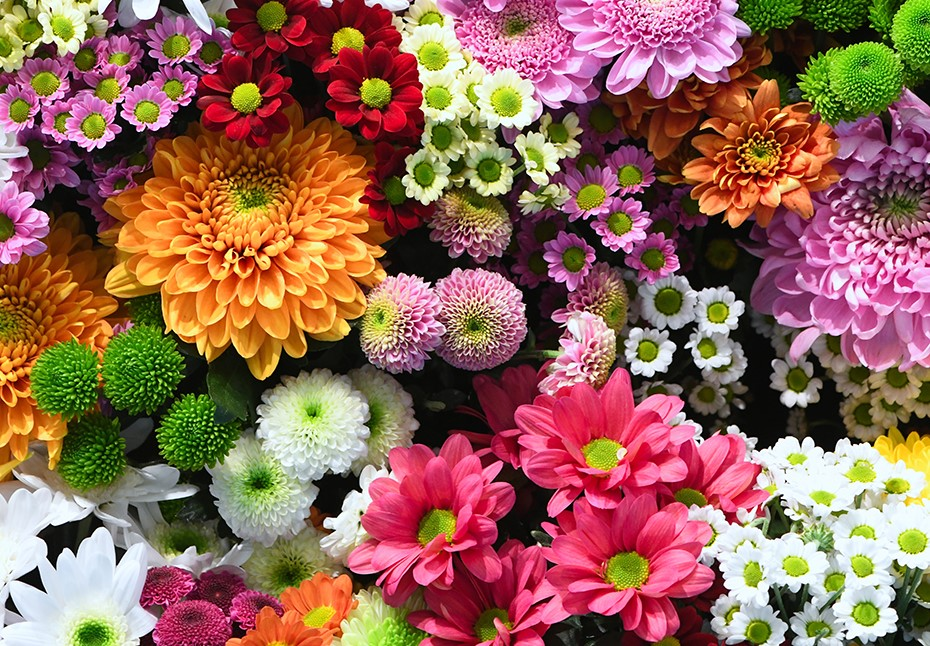

In [243]:
#reading the test image
img=cv2.imread('/content/ip3.jpg')
#showing image
cv2_imshow(img)

In [249]:
def CHEN(img,t):  
  coeffs = pywt.dwt2(img, 'haar')
  cA, (cH, cV, cD) = coeffs
  x1, y1, z1=cH.shape
  padcH=np.zeros((x1+4,y1+4,z1))
  padcH[2:x1+2,2:y1+2,:]=cH
  x2, y2, z2=cV.shape
  padcV=np.zeros((x2+4,y2+4,z2))
  padcV[2:x2+2,2:y2+2,:]=cV  
  x3, y3, z3=cD.shape
  padcD=np.zeros((x3+4,y3+4,z3))
  padcD[2:x3+2,2:y3+2,:]=cD

  x, y=padcH.shape